# Projet de visualisation de données - Étude des locations d'Airbnb en Europe

## 1 - Choix du Jeu de Données

### Pour ce projet, nous avons décidé d'analyser un dataset détaillant les séjours Airbnb dans plusieurs grandes villes européennes. Ce dataset comprend de nombreuses informations sur les logements et les séjours, comme la ville où se trouve le logement, le prix de la location, le jour de la réservation, le type de chambre (partagée ou privée), ainsi que la capacité d'accueil des logements. On y retrouve aussi des données sur la présence d'un superhôte, le nombre de chambres disponibles, et la nature du séjour (comme un séjour professionnel ou non).

### Nous avons également inclus des informations relatives à la qualité du séjour, telles que l'évaluation de la propreté et la satisfaction des invités. En ce qui concerne la localisation, des données sur la distance au centre-ville et à la station de métro permettent de mieux comprendre l'accessibilité des logements.

### En plus de cela, des indices sur les attractions locales et les restaurants viennent compléter le tableau, avec des versions normalisées de ces indices pour chaque ville. Ces informations peuvent fournir un aperçu intéressant sur l'impact de la proximité des points d'intérêt ou des commodités sur la popularité des logements.

### L'objectif principal de ce projet est de comprendre quels sont les facteurs qui influencent le marché des locations Airbnb dans les grandes villes européennes, notamment en termes de prix, de satisfaction des clients, de disponibilité et de performance des logements. Nous chercherons à analyser comment ces différents éléments interagissent et affectent les décisions des voyageurs. Par exemple, la relation entre le type de chambre, la distance au centre-ville, et la qualité des services offerts (propreté, satisfaction) peut jouer un rôle clé dans la fixation des prix.

### Nous nous intéresserons également à la manière dont ces dynamiques varient entre les différentes villes et au fil du temps. Cela permettra de dégager des tendances spécifiques à chaque région, comme les périodes de l'année où les prix augmentent, les types de logements les plus demandés, ou encore l'impact des superhôtes sur les réservations.

### Enfin, les indices d'attraction et de restaurants nous aideront à comprendre comment la proximité des sites touristiques et des restaurants influe sur la demande et sur les prix des logements, offrant ainsi une vision complète du marché Airbnb dans ces grandes villes.


### Voici le lien du dataset : https://www.kaggle.com/datasets/dipeshkhemani/airbnb-cleaned-europe-dataset

## 2 - Préparation des Données

#### Dans un premier temps, nous allons importer des biblothèques spécifiques nécessaires à l'analyse ainsi que le dataset :

In [4]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
df = pd.read_csv('airbnb.csv')

#### Affichage du dataset

In [2]:
df

,City,Price,Day,Room Type,Shared Room,Private Room,Person Capacity,Superhost,Multiple Rooms,Business,Cleanliness Rating,Guest Satisfaction,Bedrooms,City Center (km),Metro Distance (km),Attraction Index,Normalised Attraction Index,Restraunt Index,Normalised Restraunt Index
0,Amsterdam,194.033698,Weekday,Private room,False,True,2.0,False,1,0,10.0,93.0,1,5.022964,2.539380,78.690379,4.166708,98.253896,6.846473
1,Amsterdam,344.245776,Weekday,Private room,False,True,4.0,False,0,0,8.0,85.0,1,0.488389,0.239404,631.176378,33.421209,837.280757,58.342928
2,Amsterdam,264.101422,Weekday,Private room,False,True,2.0,False,0,1,9.0,87.0,1,5.748312,3.651621,75.275877,3.985908,95.386955,6.646700
3,Amsterdam,433.529398,Weekday,Private room,False,True,4.0,False,0,1,9.0,90.0,2,0.384862,0.439876,493.272534,26.119108,875.033098,60.973565
4,Amsterdam,485.552926,Weekday,Private room,False,True,2.0,True,0,0,10.0,98.0,1,0.544738,0.318693,552.830324,29.272733,815.305740,56.811677
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41709,Vienna,715.938574,Weekend,Entire home/apt,False,False,6.0,False,0,1,10.0,100.0,3,0.530181,0.135447,219.402478,15.712158,438.756874,10.604584
41710,Vienna,304.793960,Weekend,Entire home/apt,False,False,2.0,False,0,0,8.0,86.0,1,0.810205,0.100839,204.970121,14.678608,342.182813,8.270427
41711,Vienna,637.168969,Weekend,Entire home/apt,False,False,2.0,False,0,0,10.0,93.0,1,0.994051,0.202539,169.073402,12.107921,282.296424,6.822996
41712,Vienna,301.054157,Weekend,Private room,False,True,2.0,False,0,0,10.0,87.0,1,3.044100,0.287435,109.236574,7.822803,158.563398,3.832416


#### Ensuite, nous allons identifier les  principales caractérisques du dataset (type de variables, statistiques descriptives, premières lignes, valeurs nulles) :

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41714 entries, 0 to 41713
Data columns (total 19 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   City                         41714 non-null  object 
 1   Price                        41714 non-null  float64
 2   Day                          41714 non-null  object 
 3   Room Type                    41714 non-null  object 
 4   Shared Room                  41714 non-null  bool   
 5   Private Room                 41714 non-null  bool   
 6   Person Capacity              41714 non-null  float64
 7   Superhost                    41714 non-null  bool   
 8   Multiple Rooms               41714 non-null  int64  
 9   Business                     41714 non-null  int64  
 10  Cleanliness Rating           41714 non-null  float64
 11  Guest Satisfaction           41714 non-null  float64
 12  Bedrooms                     41714 non-null  int64  
 13  City Center (km)

In [4]:
df.describe()

,Price,Person Capacity,Multiple Rooms,Business,Cleanliness Rating,Guest Satisfaction,Bedrooms,City Center (km),Metro Distance (km),Attraction Index,Normalised Attraction Index,Restraunt Index,Normalised Restraunt Index
count,41714.000000,41714.000000,41714.000000,41714.000000,41714.000000,41714.000000,41714.000000,41714.000000,41714.000000,41714.000000,41714.000000,41714.000000,41714.000000
mean,260.094423,3.237235,0.295273,0.341180,9.442274,93.103179,1.165939,2.679792,0.603921,293.905990,11.719658,626.692618,25.553590
std,279.408493,1.299459,0.456171,0.474112,0.889173,8.141745,0.638157,1.996684,0.706206,235.750055,8.379161,520.644720,18.484572
min,34.779339,2.000000,0.000000,0.000000,2.000000,20.000000,0.000000,0.015045,0.002301,15.152201,0.926301,19.576924,0.592757
25%,144.016085,2.000000,0.000000,0.000000,9.000000,90.000000,1.000000,1.275913,0.236693,124.371614,5.510735,210.459574,11.132052
50%,203.819274,3.000000,0.000000,0.000000,10.000000,95.000000,1.000000,2.253237,0.391220,228.920599,9.951086,519.583509,21.814414
75%,297.373358,4.000000,1.000000,1.000000,10.000000,98.000000,1.000000,3.584489,0.678702,394.000201,15.467009,860.708156,36.821356
max,18545.450285,6.000000,1.000000,1.000000,10.000000,100.000000,10.000000,25.284557,14.273577,4513.563486,100.000000,6696.156772,100.000000


In [5]:
df.head()

,City,Price,Day,Room Type,Shared Room,Private Room,Person Capacity,Superhost,Multiple Rooms,Business,Cleanliness Rating,Guest Satisfaction,Bedrooms,City Center (km),Metro Distance (km),Attraction Index,Normalised Attraction Index,Restraunt Index,Normalised Restraunt Index
0,Amsterdam,194.033698,Weekday,Private room,False,True,2.0,False,1,0,10.0,93.0,1,5.022964,2.539380,78.690379,4.166708,98.253896,6.846473
1,Amsterdam,344.245776,Weekday,Private room,False,True,4.0,False,0,0,8.0,85.0,1,0.488389,0.239404,631.176378,33.421209,837.280757,58.342928
2,Amsterdam,264.101422,Weekday,Private room,False,True,2.0,False,0,1,9.0,87.0,1,5.748312,3.651621,75.275877,3.985908,95.386955,6.646700
3,Amsterdam,433.529398,Weekday,Private room,False,True,4.0,False,0,1,9.0,90.0,2,0.384862,0.439876,493.272534,26.119108,875.033098,60.973565
4,Amsterdam,485.552926,Weekday,Private room,False,True,2.0,True,0,0,10.0,98.0,1,0.544738,0.318693,552.830324,29.272733,815.305740,56.811677


In [6]:
df.isnull()

,City,Price,Day,Room Type,Shared Room,Private Room,Person Capacity,Superhost,Multiple Rooms,Business,Cleanliness Rating,Guest Satisfaction,Bedrooms,City Center (km),Metro Distance (km),Attraction Index,Normalised Attraction Index,Restraunt Index,Normalised Restraunt Index
0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41709,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
41710,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
41711,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
41712,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


#### Le dataset présente une disparité de variables qualitatives et quantitatives, que nous apercevons grâce aux differents types de variables Dtype (float, int ou object).

#### De plus, nous constatons que les valeurs de la médiane (égale à 203) et de la moyenne (égale à 260) sont assez proches, cela suggère généralement que la distribution des données est symétrique ou quasi symétrique, sans biais significatif ni valeurs aberrantes importantes qui influenceraient la moyenne. Il est important de noter que les prix sont dans la même unité (euro).

#### Les valeurs minimale et maximale sont tout de même très éloignées. Nous verrons par la suite que cela peut témoigner d'une forte dispersion des données. 

#### Enfin, nous constatons que notre dataset ne comporte aucune valeur manquante : cela suggère que nous n'avons nul besoin de nettoyer les données, notamment en choisissant de supprimer les lignes avec valeurs manquantes, ou bien de remplacer ces dernières avec la médiane ou la moyenne de la variable spécifique.

## 3 - Analyse Exploratoire avec Matplotlib et Seaborn

#### Pour mieux visualiser la dispersion des données et les valeurs aberrantes, nous allons créer des boîtes à moustaches : 

<AxesSubplot:>

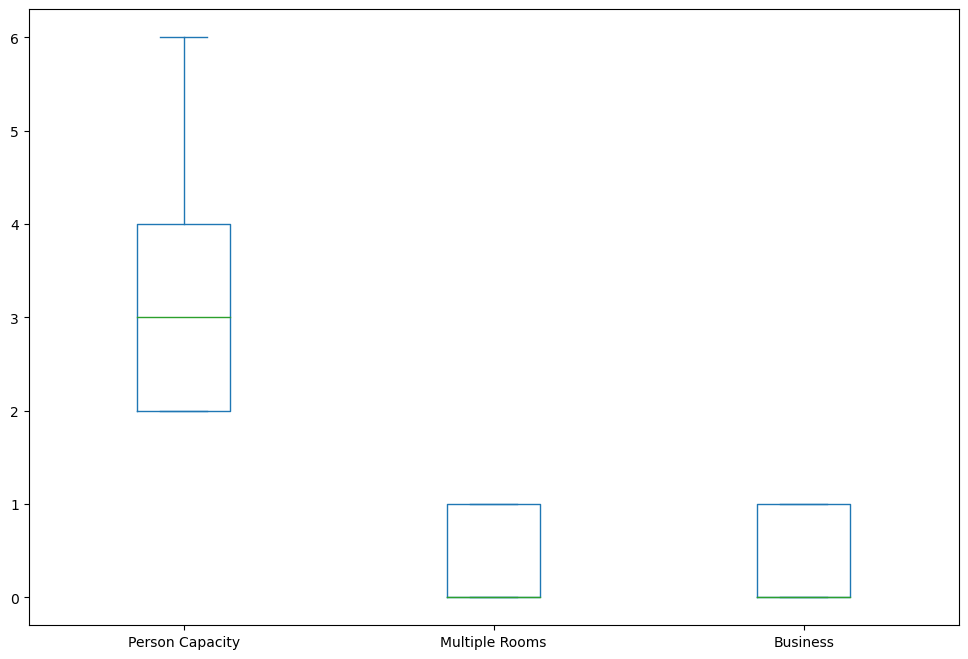

In [7]:
df[['Person Capacity','Multiple Rooms','Business']].plot.box(figsize=(12,8))

<AxesSubplot:>

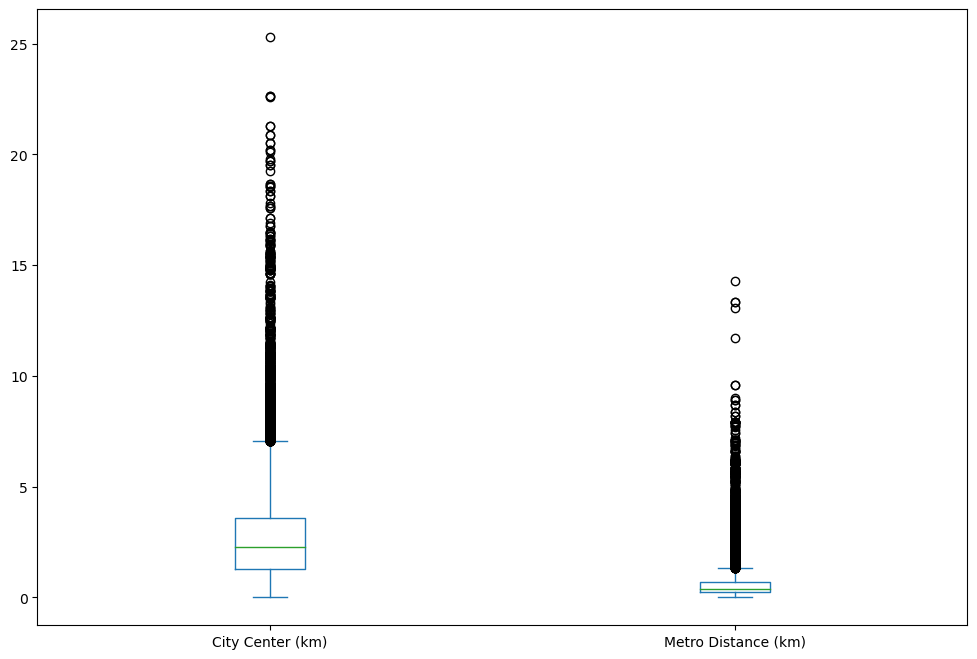

In [8]:
df[['City Center (km)','Metro Distance (km)']].plot.box(figsize=(12,8))

<AxesSubplot:>

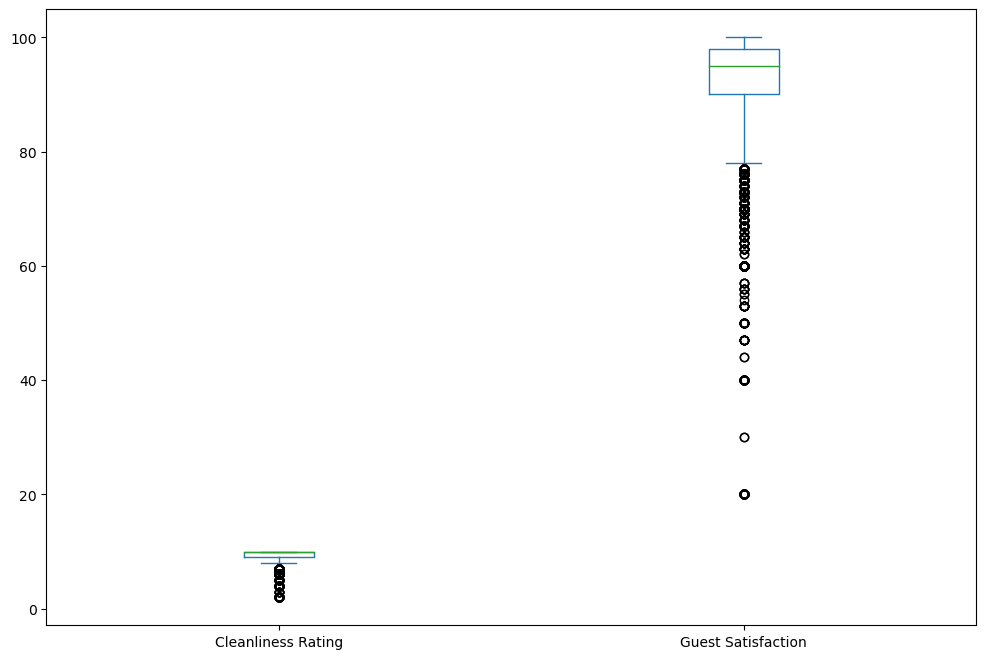

In [9]:
df[['Cleanliness Rating','Guest Satisfaction']].plot.box(figsize=(12,8))

<AxesSubplot:>

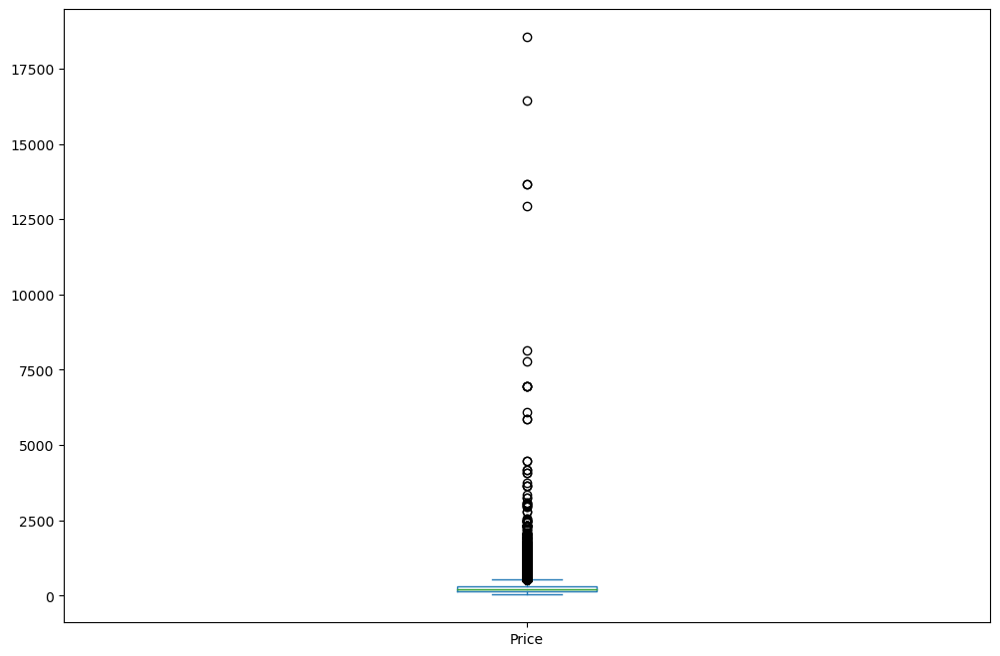

In [10]:
df['Price'].plot.box(figsize=(12,8))

#### Les différentes variables 'Person Capacity','Multiple Rooms','Business' ne présentent pas de valeurs aberrantes.
#### Cependant les variables 'City Center (km)', 'Metro Distance (km)', 'Cleanliness Rating', 'Guest Satisfaction' et 'Price' possèdent de nombreux outliers (valeurs aberrantes) : cela peut représenter des cas réels, mais rares qu'on peut par exemple expliquer par une augmentation soudaine des réservations pendant un événement national ou international.

## 4. Analyse Exploratoire des Données : Visualisations intéractives et Insights

### A. Analyse Géographique des Villes : Dynamique des Locations Airbnb

<AxesSubplot:title={'center':'Répartition des villes du dataset'}, ylabel='City'>

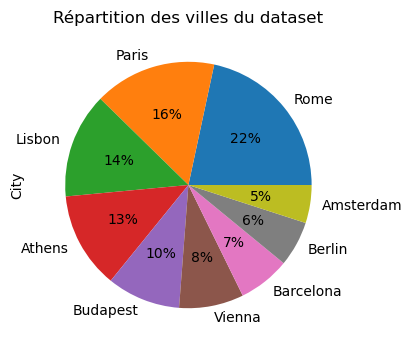

In [11]:
# Décompte du nombre de valeurs par ville dans la variable 'City'
City_count = df['City'].value_counts()

# Création du diagramme en camembert pour la variable 'City'
City_count.plot.pie(autopct='%1.0f%%', figsize=(10, 4), title="Répartition des villes du dataset")

Les données montrent que Rome, Paris et Lisbonne sont parmi les villes européennes les plus populaires pour les séjours Airbnb. 
Cela n’est pas surprenant, car Paris, par exemple, est connue comme l’une des destinations touristiques les plus prisées, tant en Europe qu’à l’échelle mondiale. En effet, Ces villes combinent une richesse historique et culturelle, une grande accessibilité grâce à des infrastructures de transport bien développées, et une diversité d’expériences pour les visiteurs, ce qui explique leur succès auprès des voyageurs.

In [12]:
# Création de l'histogramme intéractif avec plotly de la répartition du nombre de location par vile
fig = px.histogram(df, x='City', 
                   title='Répartition du nombre de location par ville',
                   labels={'City': 'Ville', 'count': 'Nombre de locations'},
                   color_discrete_sequence=['purple'],  # Couleur similaire à ton code initial
                   opacity=0.75)

# Ajustement de l'affichage
fig.update_xaxes(title_text='Ville', tickangle=45)  # Rotation des étiquettes
fig.update_yaxes(title_text='Nombre de locations')
fig.update_layout(title={'x': 0.5},  # Centrage du titre
                  bargap=0.1,  # Espace entre les barres
                  xaxis_tickformat='%s')  # Format des ticks sur l'axe x

# Affichage du graphique interactif
fig.show()

J'observe que les voyageurs privilégient particulièrement les villes de Rome, Paris, Lisbonne et Athènes. Cette préférence peut s'expliquer par leur richesse culturelle, leur attractivité touristique et leur histoire unique. Ces villes offrent une expérience complète mêlant patrimoine architectural, gastronomie locale et une multitude d'activités, ce qui en fait des destinations incontournables pour les voyageurs en quête de découvertes et de confort.

In [13]:
# Création de la carte thermique (heatmap) des notes en fonction de la vile avec plotly
fig = px.density_heatmap(
    df, 
    x='City', 
    y='Cleanliness Rating', 
    title='Histogramme des notes en fonction de la ville',
    labels={'City': 'Villes', 'Cleanliness Rating': 'Notes'},
    color_continuous_scale='YlOrBr',  # Échelle de couleurs en jaune (préconfigurée par Plotly)
    nbinsx=20, 
    nbinsy=20
)

# Ajustements supplémentaires
fig.update_xaxes(title_text='Villes', tickangle=45)  # Rotation des noms des villes
fig.update_yaxes(title_text='Notes')
fig.update_layout(title={'x': 0.5})  # Centrage du titre

# Affichage du graphique interactif
fig.show()

Les villes avec les notes de propreté les plus élevées sont Rome, Paris, Lisbonne et Athènes. Cela corrobore nos observations précédentes, selon lesquelles ces villes figurent parmi les destinations européennes les plus prisées pour des séjours en Airbnb. Cette popularité pourrait expliquer une exigence accrue en matière de qualité et d'entretien des logements, ce qui se traduit par de meilleures évaluations.

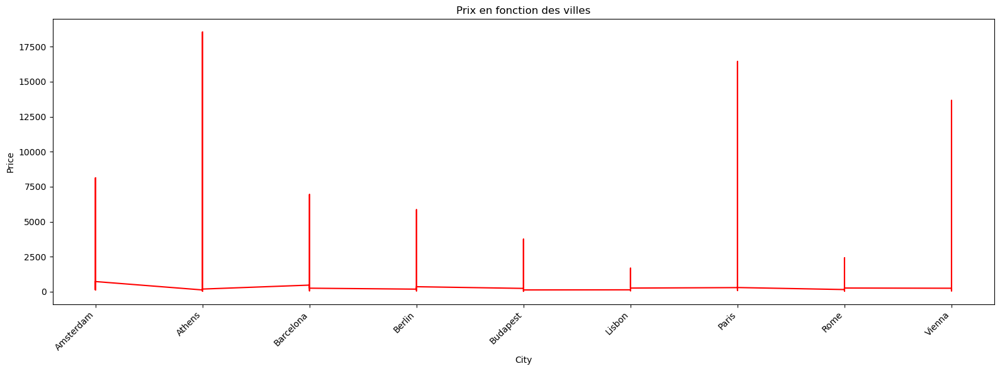

In [8]:
# Création d'un plot du prix en fonction des villes avec matplotlib
# Création des légendes, configuration des dimensions et affichage du graphique
plt.figure(figsize=(16, 6)) 
plt.plot(df['City'], df['Price'], 'r')
plt.xlabel('City')
plt.ylabel('Price')
plt.title('Prix en fonction des villes')

# Rotation des étiquettes sur l'axe X pour éviter le chevauchement
plt.xticks(rotation=45, ha='right')

plt.tight_layout()  # Ajuste automatiquement les éléments pour qu'ils ne se chevauchent pas
plt.show()

L'analyse montre que les villes avec les Airbnb les plus chers sont Athens, Paris et Vienne. On observent tout de même des valeurs asez élevées rares. Ces écarts pourraient indiquer des offres particulièrement luxueuses ou des données aberrantes comme nous l'avons mentionner précédemment.

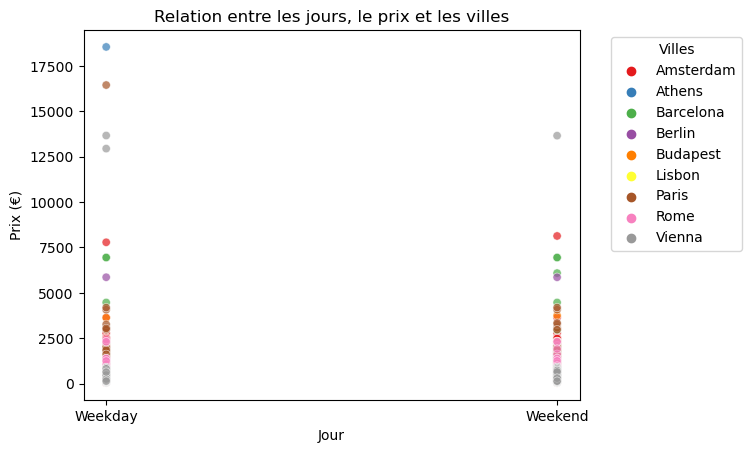

In [15]:
# Création du scatterplot entre la relation entre les jours, le prix et les villes 
# Mise en forme et affichage de ce dernier

sns.scatterplot(x='Day', y='Price', hue='City', data=df, palette='Set1', alpha=0.7)
plt.title('Relation entre les jours, le prix et les villes')
plt.xlabel('Jour')
plt.ylabel('Prix (€)')
plt.legend(title='Villes', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

On constate que les prix les plus élevés des Airbnb sont généralement observés en semaine. Cela peut s'expliquer par le fait que de nombreux voyageurs prennent des congés prolongés couvrant plusieurs jours, souvent en dehors des week-ends, ce qui incite les propriétaires à ajuster leurs tarifs à la hausse durant ces périodes. Cette stratégie pourrait refléter une demande accrue pendant ces jours spécifiques, notamment de la part de touristes ou de professionnels en déplacement.

### B. Satisfaction Client : Comprendre les Facteurs Influents dans les Locations Airbnb

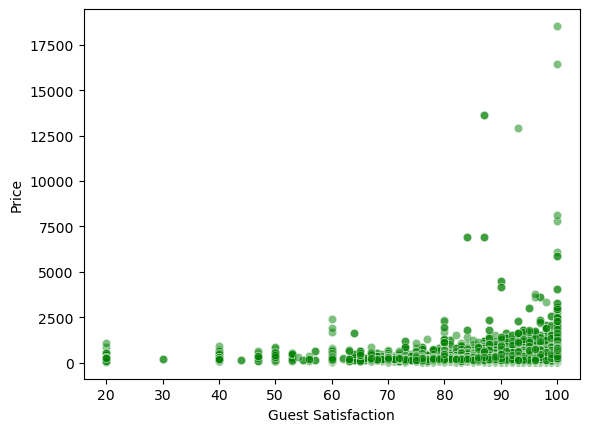

In [16]:
plt.plot(figsize=(30,4))
sns.scatterplot(x='Guest Satisfaction',y='Price',data=df, color='green', alpha=0.5)
plt.show()

L'analyse montre une tendance où la satisfaction des voyageurs augmente avec le prix des séjours. 
Cela peut s'expliquer par le fait que des tarifs plus élevés sont souvent associés à un certain niveau de standing, de confort ou de services proposés par les hébergements Airbnb. Cette corrélation positive est encourageante, car elle suggère que les voyageurs sont prêts à payer davantage pour bénéficier d'une expérience de meilleure qualité.

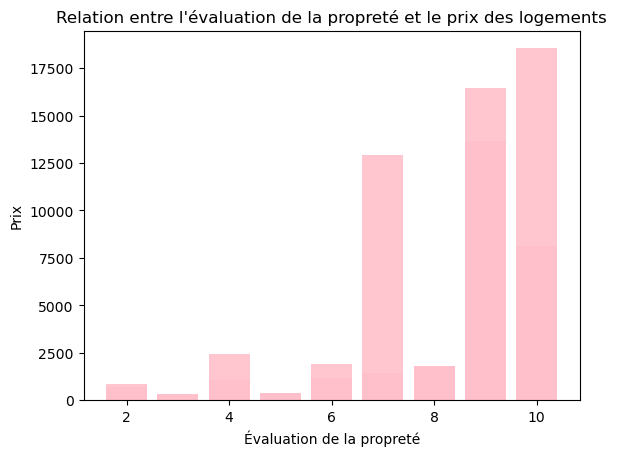

In [12]:
# Création d'un histogramme de l'évolution de la propreté en fonction du prix
# Création de sa légende

plt.bar(df['Cleanliness Rating'], df['Price'], color='pink', alpha=0.9)
plt.xlabel('Évaluation de la propreté')
plt.ylabel('Prix')
plt.title('Relation entre l\'évaluation de la propreté et le prix des logements')
plt.show()

On observe que les logements avec des prix plus élevés obtiennent généralement de meilleures évaluations en matière de propreté. Cela confirme l’interprétation précédente, où un prix plus élevé est souvent associé à une meilleure expérience globale. Une bonne évaluation de la propreté est un critère essentiel pour les voyageurs, et elle semble être proportionnelle au niveau de standing offert par l’hébergement.

### C. Analyse selon le type de location

#### Afin d'avoir une meilleure vue d'ensemble des prix des logements selon leur catégorie regardons la fréquence des logements ainsi que leur densité.

C:\Users\annam\anaconda3\Python\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



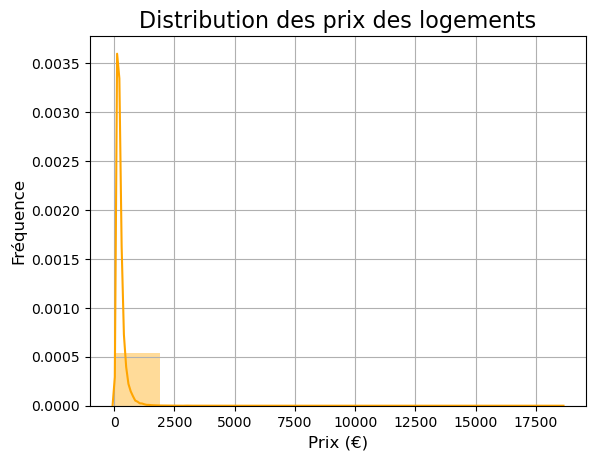

In [18]:
# Création d'une visualisation de la fréquence avec distplot et seaborn, et mise en forme de ce graphique
sns.distplot(df['Price'], kde=True, bins=10, color='orange')
plt.title('Distribution des prix des logements', fontsize=16)
plt.xlabel('Prix (€)', fontsize=12)
plt.ylabel('Fréquence', fontsize=12)
plt.grid(True)
plt.show()

On observe que la majorité des prix des logements se concentrent autour de 2200 €, avec une fréquence élevée pour les prix proches de cette valeur. Cependant, les logements très chers sont relativement rares. Cela suggère qu'il existe une forte demande pour des logements dans cette gamme de prix intermédiaire, mais une quantité limitée de logements réellement onéreux. Cette concentration des prix indique que la plupart des hôtes ciblent des prix abordables ou modérés, et que le marché devient plus difficile pour ceux qui souhaitent proposer des logements à des prix nettement plus élevés. Le marché est donc plutôt axé sur des prix compétitifs, avec peu de place pour les logements haut de gamme.

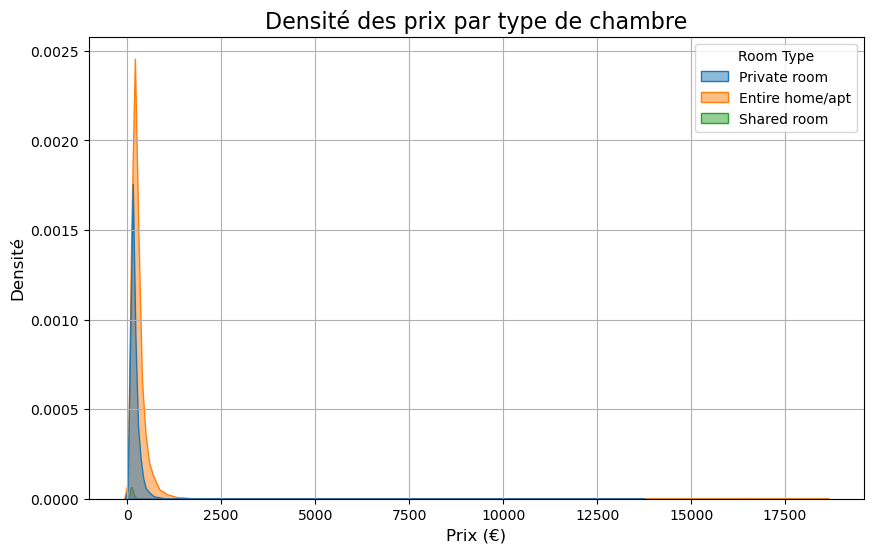

In [19]:
# Création d'un graphique de la densité des prix par type de chambre 
# Mise en forme de ce dernier

plt.figure(figsize=(10, 6))
sns.kdeplot(data=df, x='Price', hue='Room Type', shade=True, alpha=0.5)

plt.title("Densité des prix par type de chambre", fontsize=16)
plt.xlabel("Prix (€)", fontsize=12)
plt.ylabel("Densité", fontsize=12)
plt.grid(True)
plt.show()

D'après l'analyse de la densité des prix en fonction des types de logements, on constate que la densité est plus forte pour les logements où les voyageurs ont l'intégralité du logement à leur disposition, en particulier à bas coût. Cela suggère que ces types de logements sont proposés en grande quantité dans la gamme de prix plus abordable, ce qui les rend accessibles à un plus grand nombre de voyageurs.

En revanche, pour les chambres partagées, la densité est très faible à bas coût, ce qui pourrait indiquer que ces logements à bas prix sont relativement rares ou moins fréquents, peut-être en raison de la nature moins attrayante de ce type de logement pour certains voyageurs, ou bien parce qu'ils sont souvent proposés à des prix plus compétitifs par rapport aux autres types de logement. Cela pourrait aussi refléter un déséquilibre entre l'offre et la demande pour les chambres partagées à bas coût.

In [20]:
# Création d'un histogramme intéractif avec plotly du nombre de lits en fonction du nombre de locations
fig = px.histogram(df, x='Bedrooms', 
                   title='Nombre de lits en fonction du nombre de locations',
                   labels={'Bedrooms': 'Nombre de lits', 'count': 'Nombre de locations'},
                   color_discrete_sequence=['blue'], 
                   opacity=0.75,
                   nbins=20)  
fig.update_xaxes(title_text='Nombre de lits') 
fig.update_yaxes(title_text='Nombre de locations')  
fig.update_layout(title={'x': 0.5},  
                  bargap=0.1)  
fig.show()

En observant le graphique interactif, on constate que les logements avec un seul lit sont de loin les plus nombreux dans les offres disponibles sur Airbnb. Cela peut s’expliquer par le profil typique des voyageurs ciblés par ces offres : des couples ou des voyageurs seuls, qui représentent une part importante des utilisateurs d'Airbnb.

Cette observation est cohérente avec la logique du marché : les logements d'une chambre sont souvent plus abordables et répondent aux besoins de nombreux touristes ou professionnels voyageant seuls ou en petit groupe.

Cela soulève également une opportunité d'analyse complémentaire : il aurait été pertinent d'avoir une variable indiquant le type de voyageurs (seul, couple, famille, groupe d'amis) pour mieux comprendre la corrélation entre le type de logement et le profil des utilisateurs. Une telle donnée aurait permis d'affiner l'analyse et d’apporter des insights plus précis sur la demande en fonction des caractéristiques des voyageurs.

<AxesSubplot:>

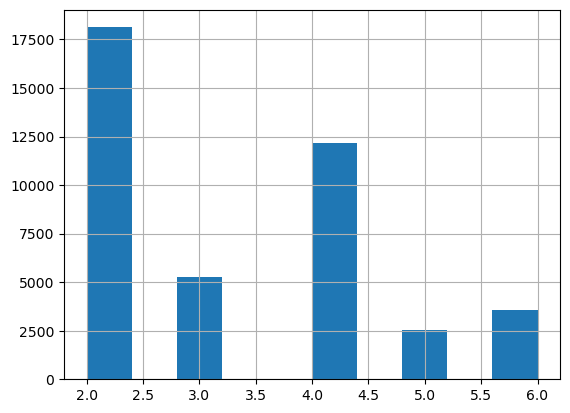

In [21]:
df['Person Capacity'].hist()

On observe que la majorité des logements ont une capacité d'accueil de deux personnes, ce qui est cohérent avec le fait que le nombre de lits le plus récurrent est de 1. Le nombre de lits de 2 arrive en deuxième position, ce qui indique que beaucoup de logements sont adaptés à des couples ou des voyageurs seuls. De plus, la capacité d'accueil de 4 personnes se classe également parmi les plus fréquentes, ce qui peut être lié à des familles ou des groupes d'amis. Cette tendance suggère que les hôtes privilégient généralement des configurations adaptées aux couples, ce qui est en accord avec le type de voyageurs qui cherchent souvent des logements plus intimes et plus abordables.

In [22]:
# Création d'un histogramme intéractif avec plotly du type de location en fonction du nombre de locations
fig = px.histogram(df, x='Room Type', 
                   title='Type de location en fonction du nombre de locations',
                   labels={'Room Type': 'Type de location', 'count': 'Nombre de locations'},
                   color_discrete_sequence=['blue'],  # Couleur similaire à ton code initial
                   opacity=0.75)

# Ajustements de l'affichage
fig.update_xaxes(title_text='Type de location')  # Libellé de l'axe des x
fig.update_yaxes(title_text='Nombre de locations')  # Libellé de l'axe des y
fig.update_layout(title={'x': 0.5},  # Centrage du titre
                  bargap=0.1)  # Espace entre les barres

# Affichage du graphique interactif
fig.show()

L'analyse montre que les voyageurs privilégient principalement les logements où ils ont l'ensemble de l'appartement à leur disposition. En revanche, bien que les chambres privées dans des logements partagés attirent un nombre conséquent de voyageurs, elles sont nettement moins populaires que les logements entiers. Enfin, les chambres partagées représentent une part minime du marché, une proportion qui pourrait presque être négligée dans l’analyse globale. Ces tendances suggèrent que les voyageurs privilégient davantage l’intimité et l'espace offert par la location d'un logement entier.

Comme nous l'avons vu précédement, cette préférence des propriétaires pour les logements avec une seule chambre s’aligne également avec cette observation que nous avons juste au dessus: les voyageurs privilégient les logements où ils ont accès à la totalité de l’appartement. Cela reflète une recherche d’intimité et de confort, ce qui est particulièrement attractif pour les couples ou les voyageurs solos, souvent à la recherche d’une expérience de séjour plus personnelle et indépendante.

In [23]:
# Création de boîtes à moustaches avec plotly du type de logement en fonction du prix
fig = px.box(df, x='Room Type', y='Price', 
             title='Comparaison des prix en fonction du type de logement',
             labels={'Room Type': 'Type de location', 'Price': 'Prix'},
             color='Room Type', 
             boxmode='group')
fig.show()

Les locations offrant un logement entierement à disposition des voyageurs demeurent les plus onéreuses. Cependant, le prix ne semble pas être un frein si le standing proposé correspond aux attentes, car ces logements restent les plus prisés. À l'inverse, les chambres partagées, bien que nettement moins chères, offrent une alternative économique qui peut attirer une clientèle différente, créant ainsi une concurrence intéressante sur le marché des locations Airbnb. Cependant on observe des prix excessifs qui pourrait indiquer la présence de valeurs aberrantes dans les données, possiblement dues à des logements particulièrement luxueux ou atypiques, qui faussent la tendance générale du marché.

### D. Dynamique des Variables en Relation avec la Proximité aux Points d'Intérêt Urbains

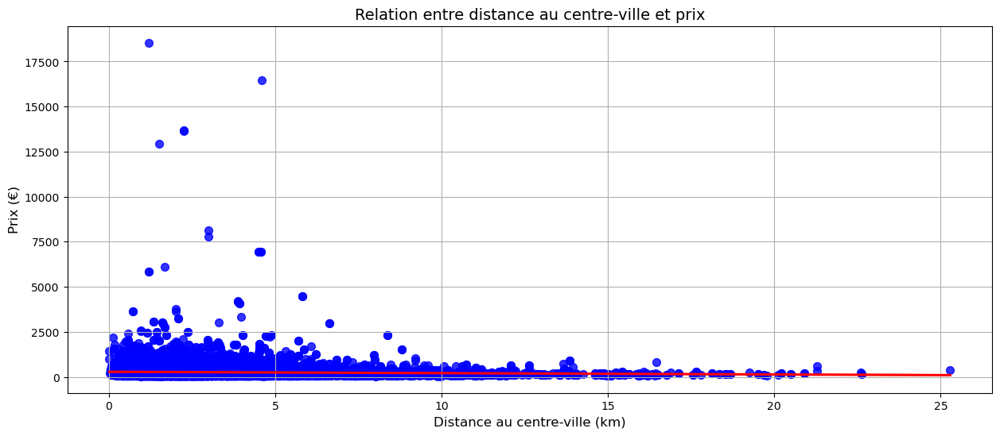

In [24]:
plt.figure(figsize=(15, 6))

# Utilisation de seaborn pour créer un scatter plot avec une ligne de régression
sns.regplot(x='City Center (km)', y='Price', data=df, scatter_kws={'color': 'blue', 's': 50}, line_kws={'color': 'red'}, ci=None)

# Titres et labels
plt.title("Relation entre distance au centre-ville et prix", fontsize=14)
plt.xlabel("Distance au centre-ville (km)", fontsize=12)
plt.ylabel("Prix (€)", fontsize=12)

# Affichage du graphique
plt.grid(True)
plt.show()

On constate que les logements les moins chers sont souvent ceux qui se trouvent à une distance plus courte du centre-ville. Cela pourrait s'expliquer par plusieurs facteurs. D'une part, les logements proches du centre-ville peuvent être plus facilement accessibles et bénéficier d'une meilleure infrastructure de transport, ce qui peut attirer davantage de voyageurs à la recherche de commodités et d'une bonne connectivité. Par conséquent, ces logements peuvent être proposés à des prix plus compétitifs pour attirer une clientèle désireuse de séjourner dans des zones centrales sans nécessairement payer un prix élevé.

Cependant, il est également possible que les logements plus éloignés du centre-ville offrent des prix plus bas en raison de l'accès moins direct aux principales attractions touristiques et de la demande plus faible dans ces zones.

Cela pourrait également indiquer une stratégie tarifaire des hôtes qui cherchent à compenser la distance en offrant des prix plus attractifs.

<AxesSubplot:xlabel='Room Type', ylabel='Metro Distance (km)'>

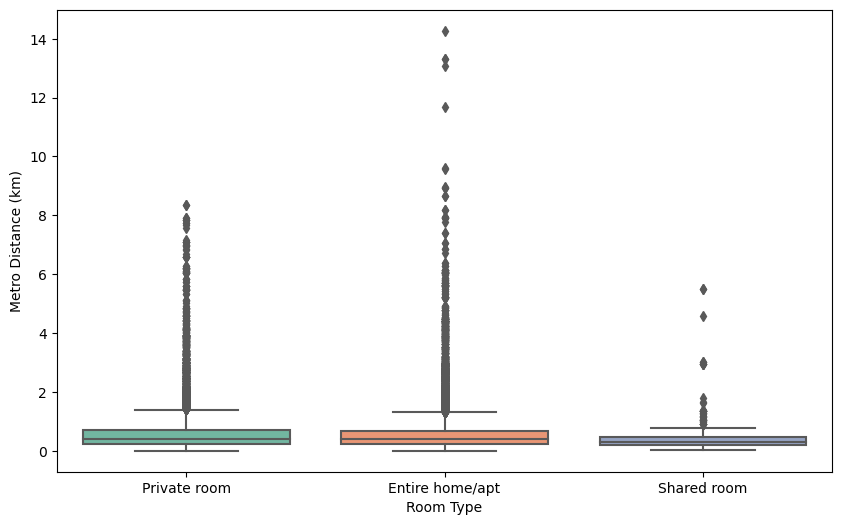

In [25]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=df, x='Room Type', y='Metro Distance (km)', palette="Set2")

D'après l'analyse du graphique en boîte, on observe qu'il n'y a pas beaucoup de différence entre les chambres privées et les logements où les voyageurs ont l'intégralité du logement à leur disposition en ce qui concerne la distance au centre-ville. Les deux types de logements semblent être assez éloignés du centre-ville, ce qui suggère qu'ils sont souvent situés dans des zones résidentielles ou périphériques des grandes villes.

En revanche, les chambres partagées, bien que moins nombreuses, tendent à être situées plus près du centre-ville. Cela pourrait être dû au fait que ces logements sont souvent proposés à des prix plus abordables, ce qui rend plus facile l'accès à des endroits plus centraux et stratégiques. Cette proximité au centre-ville peut être un avantage pour attirer les voyageurs recherchant un logement économique tout en étant bien situé pour visiter la ville.

In [26]:
# Création d'un scatterplot intéractif avec plotly du prix des logements en fonction de la distance au métro
# Affichage du graphique

fig = px.scatter(df, x='Metro Distance (km)', y='Price', color='Room Type',
                 title="Prix des logements en fonction de la distance au métro",
                 labels={"Metro Distance (km)": "Distance au Métro (km)", "Price": "Prix (€)"},
                 hover_data=['Room Type'])
fig.show()

Grâce à cette visualisation, les logements les plus prisés, c’est-à-dire ceux où les voyageurs ont l’intégralité de leur logement à leur disposition, (comme nous l'avons vu précedemment) sont souvent situés à une certaine distance du métro. Cependant, certains restent tout de même assez onéreux malgré cette éloignement. En revanche, les chambres partagées, bien que moins populaires, apparaissent comme plus compétitives, car elles sont généralement situées plus près du métro, ce qui les rend plus accessibles pour les voyageurs souhaitant privilégier la proximité des transports."

### 5. Résumé

#### Après avoir exploré et analysé en détail le dataset, nous allons maintenant résumer les principales conclusions tirées de nos observations, afin de mettre en lumière les facteurs clés influençant le marché des locations Airbnb dans les grandes villes européennes.

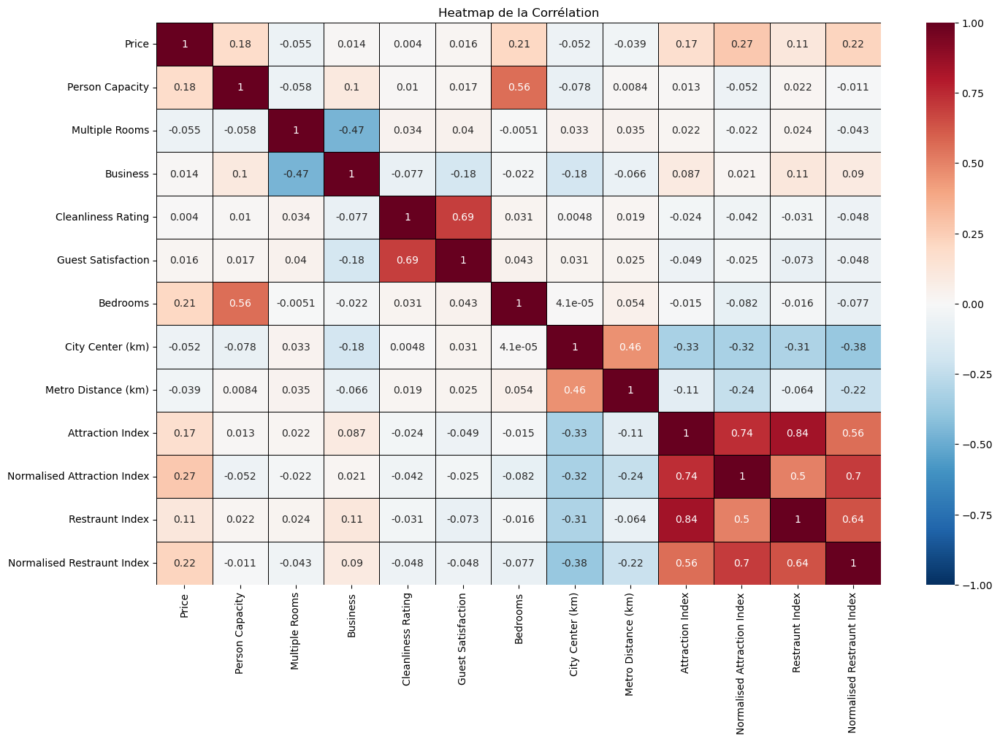

In [27]:
#sns.set(font_scale=0.9)
df_numeric = df.select_dtypes(include=['float64', 'int64'])

# Création de la heatmap de la corrélation
plt.figure(figsize=(16, 10))
sns.heatmap(df_numeric.corr(), cmap='RdBu_r', annot=True, vmin=-1, vmax=1,
            linewidths=0.5, linecolor='black', square=False)
plt.title('Heatmap de la Corrélation')
plt.show()

Il est logique que les variables person capacity (capacité d'accueil) et bedrooms (nombre de chambres) soient fortement corrélées, car généralement, un logement avec plus de chambres peut accueillir un plus grand nombre de personnes. En effet, chaque chambre supplémentaire permet d’ajouter des lits, ce qui augmente la capacité d'accueil globale du logement. Cette corrélation reflète le fait qu'un logement plus spacieux, avec plus de chambres, peut accueillir davantage de voyageurs, ce qui est une relation naturelle entre ces deux variables.

La corrélation entre la cleanliness rating (note de propreté) et la guest satisfaction (satisfaction des invités) est également attendue. En général, la propreté d'un logement est un facteur clé pour les voyageurs lorsqu'ils évaluent leur satisfaction. Un logement propre est perçu comme un environnement agréable et confortable, ce qui peut conduire à des évaluations plus positives en termes de satisfaction. Ainsi, les voyageurs qui attribuent une bonne note à la propreté sont susceptibles d'exprimer également un haut niveau de satisfaction global, ce qui montre que la propreté joue un rôle crucial dans l'expérience globale du séjour.

##### Dans le cadre de ce projet, nous avons analysé un dataset détaillant les caractéristiques des logements Airbnb en Europe, incluant des informations sur le type de logement, les prix, la satisfaction des voyageurs, la distance par rapport aux attractions, et d'autres variables liées à l'emplacement. L'objectif principal était d'identifier les facteurs clés influençant le marché des locations Airbnb, notamment en termes de prix, de satisfaction des clients, de disponibilité et de performance, et de comprendre comment ces dynamiques varient selon les villes et au fil du temps.

##### À travers une analyse exploratoire approfondie utilisant des outils comme Matplotlib, Seaborn et Plotly, nous avons pu mettre en lumière plusieurs tendances. Nous avons observé que les prix des logements sont fortement influencés par la localisation, notamment par la distance aux centres-villes et aux stations de métro. Les logements offrant l’intégralité de l’appartement à des prix élevés sont généralement les plus prisés, tandis que les chambres partagées, bien que moins nombreuses, restent très proches du métro et sont relativement compétitives sur le marché. De plus, une corrélation évidente entre la propreté du logement et la satisfaction des voyageurs a renforcé l’importance de maintenir un bon niveau de qualité pour garantir des évaluations positives.

##### L’analyse a également révélé que certaines variables sont fortement corrélées, telles que le nombre de chambres et la capacité d’accueil, ce qui est logique puisqu'un logement plus grand peut accueillir davantage de personnes. De même, les indices d'attraction et leur version normalisée montrent une forte corrélation, soulignant l'importance des attractions touristiques dans le choix des voyageurs. Globalement, notre étude met en lumière les facteurs déterminants du marché Airbnb en Europe, en offrant une vision claire de ce qui influence les prix et la satisfaction des utilisateurs.

### KUTU KIALANDA Flavie
### ANNAMALE Dhanajayan
### IA.B3